In [73]:
import torch
import pandas as pd
from pathlib import Path
import sys
import json
import ast
import numpy as np
import matplotlib.pyplot as plt
# notebook location
project_root = Path().resolve().parent.parent
sys.path.insert(0, str(project_root))
print("Added to path:", project_root)
from utils.general_utils import open_file, load_all_h5files_from_folder
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from ft_comparisons import load_results
from utils.III_results_analysis.utils import load_all_results,mean_std_confusion_matrices, return_data_directories
from utils.I_data_preparation.experimental_config import ORIGINAL_LABELS, FS
from utils.I_data_preparation.visualizations import plot_emg_color_by_label

Added to path: /home/gspacone/Desktop/SilentWear


In [ ]:
fig_save_path = Path("/scratch2/gspacone/sensors_2026_final_neworder/figures/time_series")

In [ ]:
subject_to_consider = "S01"
condition = 'silent'

# Plotting data

In [231]:

def find_all_processed_h5(main_data_dire_folder, subject):
    "Function to return all h5 files contained in the processed directory"
    # Find all .bio files under the subject raw folder
    h5_files = sorted((main_data_dire_folder/'processed_final'/subject).rglob("*.h5"))
    #print("Found files for current user:")
    #print(h5_files)
    return h5_files


In [64]:
main_data_dire_folder = Path("/baltic/users/ml_datasets/iis_bio_internal_datasets/2026_spacone_speech_classification_hmi")
h5_files = find_all_processed_h5(main_data_dire_folder, subject_to_consider)

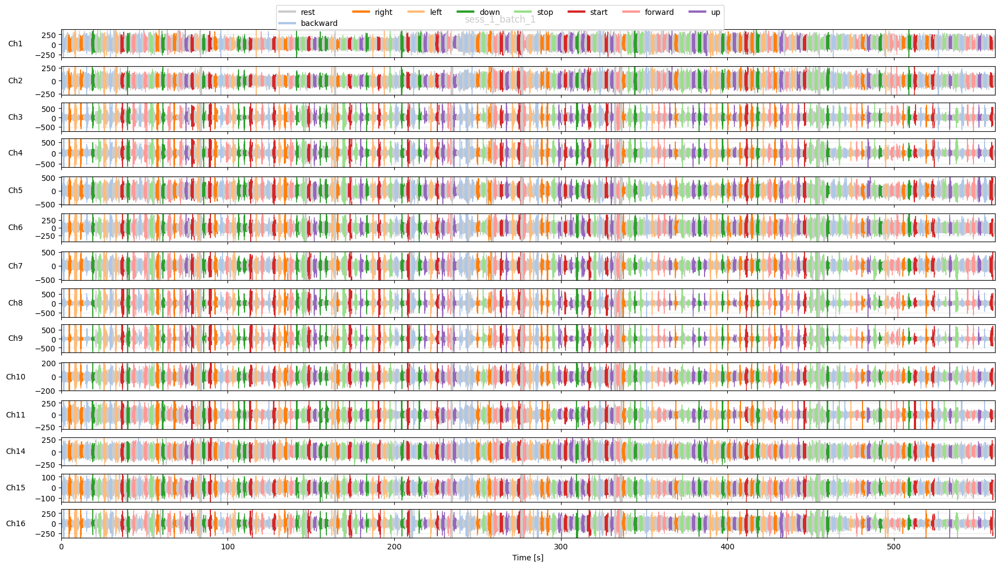

In [52]:
proc_data_dire = main_data_dire_folder/"processed_final"

for h5_file in h5_files:
    if h5_file.parent.name == condition:
        emg_df =  pd.read_hdf(h5_file, key='emg')
        title = h5_file.stem
        #plot_emg_color_by_label(emg_df, fs=FS, use_filtered=True, title=title, save_path=f"{fig_save_path}/{subject_to_consider}_{condition}_{title}.png")
        break
        

In [53]:
unique_words = list(emg_df["Label_str"].unique())

In [59]:
unique_words = ["rest", "up", "down", "left", "right", "start", "stop", "forward", "backward"]
word_title = ["REST", "UP", "DOWN", "LEFT", "RIGHT", "START","STOP", "FORWARD", "BACKWARD"]

In [54]:
def check_word_bounderies(emg_word):
    idx_word = emg_word.index
    # identify start and stops
    idx_prev = idx_word[0]
    idxs_stop = []
    idxs_start = []
    idxs_start.append(idx_word[0])
    for idx_curr in idx_word[1:]:

        if idx_curr!= idx_prev+1:
            # new repetition
            idxs_stop.append(idx_prev)
            idxs_start.append(idx_curr)
        idx_prev = idx_curr
    idxs_stop.append(idx_word[-1])
    idxs_start = np.array(idxs_start)
    idxs_stop = np.array(idxs_stop)

    return idxs_start, idxs_stop

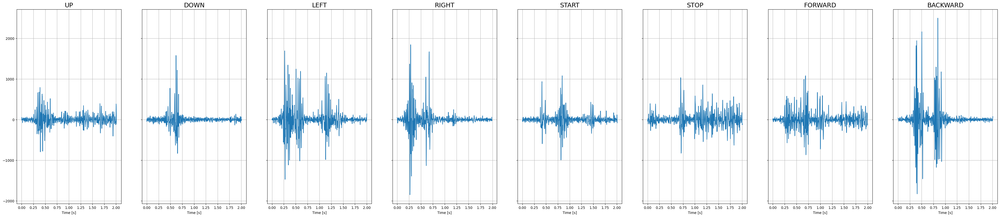

In [60]:
# plot some words for reference
Ch_to_plot = 'Ch_8_filt'
fig, axs = plt.subplots(1, 8, figsize=(50,10), sharey = True)
axs_cnt = 0

for word_cnt, word in enumerate(unique_words):
    if word == 'rest':
        continue
    else:
        emg_word = emg_df[emg_df["Label_str"] == word]
        idx_word_start, idx_word_stop = check_word_bounderies(emg_word)
        ch_to_plot = emg_word[Ch_to_plot]
        # select one random sample
        ch = ch_to_plot.loc[idx_word_start[0] : idx_word_stop[0]]
        x_axis = np.linspace(0, len(ch)/FS, len(ch))
        axs[axs_cnt].plot(x_axis, ch)
        axs[axs_cnt].set_title(word_title[word_cnt], fontsize=18)
        axs[axs_cnt].grid(True)
        axs[axs_cnt].set_xlabel('Time [s]')
        axs_cnt+=1

### Both silent and vocalized

In [87]:
proc_data_dire = main_data_dire_folder/"processed_final"
conditions = ["vocalized","silent"]
already_plotted = {"silent": False, "vocalized": False}

for h5_file in h5_files:
    for condition in conditions:
        if h5_file.parent.name == condition:
            if already_plotted[condition] == False:
                if condition == 'vocalized':
                    h5_file_vocalized = h5_file
                if condition == 'silent':
                    h5_file_silent = h5_file

In [ ]:
# Some settings
# SUB 4. Run the script and select idx 2-2

In [75]:
import matplotlib.patches as patches


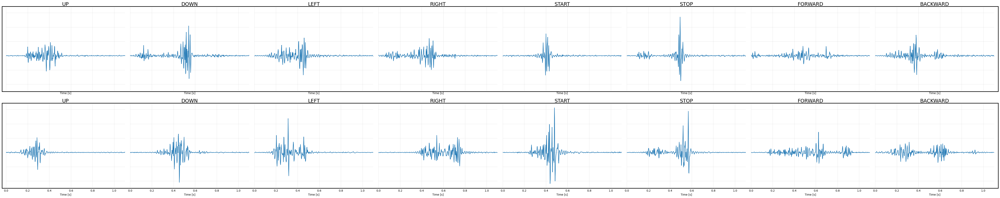

In [81]:
fig, axs = plt.subplots(2, 8, figsize=(50,10), sharey = True, sharex=True)
proc_data_dire = main_data_dire_folder/"processed_final"
conditions = ["vocalized","silent"]
already_plotted = {"silent": False, "vocalized": False}
for h5_file in h5_files:
    for condition in conditions:
        if h5_file.parent.name == condition:
            if already_plotted[condition] == False:
                if condition == 'vocalized':
                    axs_row = 0
                else:
                    axs_row = 1
                emg_df =  pd.read_hdf(h5_file, key='emg')
                title = h5_file.stem


                # plot some words for reference
                Ch_to_plot = 'Ch_8_filt'
                
                axs_word_cnt = 0

                for word_cnt, word in enumerate(unique_words):
                    if word == 'rest':
                        continue
                    else:
                        emg_word = emg_df[emg_df["Label_str"] == word]
                        idx_word_start, idx_word_stop = check_word_bounderies(emg_word)
                        ch_to_plot = emg_word[Ch_to_plot]
                        # select one random sample
                        ch = ch_to_plot.loc[idx_word_start[2] : idx_word_stop[2]]
                        x_axis = np.linspace(0, len(ch)/FS, len(ch))
                        axs[axs_row][axs_word_cnt].plot(x_axis, ch)
                        axs[axs_row][axs_word_cnt].set_title(word_title[word_cnt], fontsize=18)
                        axs[axs_row][axs_word_cnt].grid(True, alpha=0.3)
                        axs[axs_row][axs_word_cnt].set_xlabel('Time [s]')
                        axs[axs_row][axs_word_cnt].set_xlim(0,1.1)
                        axs_word_cnt+=1
                already_plotted[condition] = True

# --- after all plots are created ---
fig.tight_layout()  # or constrained_layout=True at subplots creation
n_rows, n_cols = axs.shape

for i in range(n_rows):
    for j in range(n_cols):
        ax = axs[i, j]

        # Remove ALL spines
        for spine in ax.spines.values():
            spine.set_visible(False)

        # Optional: remove tick marks but keep labels
        ax.tick_params(left=False, bottom=False)
        if j != 0:
            ax.set_yticklabels([])

def add_row_box(fig, axs_row, pad=0.006, lw=2.0):
    """
    Draw a single rectangle around an entire row of axes.
    pad is in figure fraction units.
    """
    axs_row = np.atleast_1d(axs_row)

    # union bbox of the row in figure coordinates
    bboxes = [ax.get_position() for ax in axs_row]
    x0 = min(b.x0 for b in bboxes) - pad
    y0 = min(b.y0 for b in bboxes) - pad
    x1 = max(b.x1 for b in bboxes) + pad
    y1 = max(b.y1 for b in bboxes) + pad

    rect = patches.Rectangle(
        (x0, y0), x1 - x0, y1 - y0,
        transform=fig.transFigure,
        fill=False,
        linewidth=lw,
        edgecolor="black",
        zorder=1000,
        clip_on=False
    )
    fig.add_artist(rect)

# one shared box for top row and one for bottom row
add_row_box(fig, axs[0, :], pad=0.004, lw=2.0)
add_row_box(fig, axs[1, :], pad=0.004, lw=2.0)

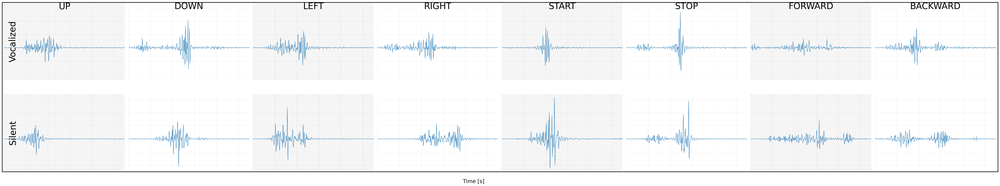

In [85]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# ---------------- FIGURE / AXES ----------------
fig, axs = plt.subplots(2, 8, figsize=(50, 10), sharex=True, sharey=True)

# --- MANUAL LAYOUT: create room INSIDE the big box for row/col labels ---
# These numbers control everything. Tweak slightly if needed.
L, R = 0.055, 0.995   # left/right of the whole panel (figure fraction)
B, T = 0.10, 0.90     # bottom/top of the whole panel
fig.subplots_adjust(left=L, right=R, bottom=B, top=T, wspace=0.03, hspace=0.18)

# Bands INSIDE the box
header_h = 0.035   # height reserved for column titles inside the box
side_w   = 0.018   # width reserved for row titles inside the box

# ---------------- PLOTTING ----------------
proc_data_dire = main_data_dire_folder/"processed_final"
conditions = ["vocalized","silent"]
already_plotted = {"silent": False, "vocalized": False}

for h5_file in h5_files:
    for condition in conditions:
        if h5_file.parent.name == condition and not already_plotted[condition]:

            axs_row = 0 if condition == "vocalized" else 1
            emg_df = pd.read_hdf(h5_file, key="emg")
            Ch_to_plot = "Ch_8_filt"

            axs_word_cnt = 0
            for word_cnt, word in enumerate(unique_words):
                if word == "rest":
                    continue

                emg_word = emg_df[emg_df["Label_str"] == word]
                idx_word_start, idx_word_stop = check_word_bounderies(emg_word)

                ch_to_plot = emg_word[Ch_to_plot]
                ch = ch_to_plot.loc[idx_word_start[2] : idx_word_stop[2]]
                x_axis = np.linspace(0, len(ch)/FS, len(ch))

                ax = axs[axs_row, axs_word_cnt]
                ax.plot(x_axis, ch, linewidth=0.9)
                ax.grid(True, alpha=0.25)
                ax.set_xlim(0, 1.1)

                axs_word_cnt += 1

            already_plotted[condition] = True

# ---------------- STYLE: remove internal spines / clutter ----------------
n_rows, n_cols = axs.shape

for i in range(n_rows):
    for j in range(n_cols):
        ax = axs[i, j]

        # remove all spines
        for sp in ax.spines.values():
            sp.set_visible(False)

        # tidy ticks
        ax.tick_params(left=False, bottom=False, labelsize=10)

        # only first column keeps y tick labels
        if j != 0:
            ax.set_yticklabels([])

        # only bottom row keeps x tick labels
        if i != n_rows - 1:
            ax.set_xticklabels([])

# ---------------- INTERLEAVED COLUMN BACKGROUNDS ----------------
for j in range(n_cols):
    if j % 2 == 0:
        for i in range(n_rows):
            axs[i, j].set_facecolor((0, 0, 0, 0.04))

# ---------------- SHARED X LABEL ----------------
fig.supxlabel("Time [s]", fontsize=18, y=0.04)

# ---------------- ONE SINGLE OUTER BOX ----------------
# Draw the box exactly using the known panel limits (L,R,B,T)
# and INCLUDE the header/side bands INSIDE the box by expanding slightly.
box_x0 = L - 0.002
box_y0 = B - 0.002
box_x1 = R + 0.002
box_y1 = T + 0.002

rect = patches.Rectangle(
    (box_x0, box_y0),
    box_x1 - box_x0,
    box_y1 - box_y0,
    transform=fig.transFigure,
    fill=False,
    linewidth=2.0,
    edgecolor="black",
    zorder=1000,
    clip_on=False
)
fig.add_artist(rect)

# ---------------- COLUMN TITLES (WORDS) INSIDE THE BOX ----------------
# Place them in the header band: between (T-header_h) and T
y_words = T - 0.5 * header_h

# centers from the top-row axes positions
col_centers = [0.5 * (axs[0, j].get_position().x0 + axs[0, j].get_position().x1) for j in range(n_cols)]

# build labels aligned with 8 columns (skipping 'rest')
col_labels = []
for word_cnt, w in enumerate(unique_words):
    if w == "rest":
        continue
    col_labels.append(word_title[word_cnt])

for cx, lab in zip(col_centers, col_labels):
    fig.text(cx, y_words, lab, ha="center", va="center", fontsize=30)

# ---------------- ROW TITLES (CONDITIONS) INSIDE THE BOX ----------------
# Put them in the side band: near left border, centered per row
row_names = ["Vocalized", "Silent"]
for i, lab in enumerate(row_names):
    bb = axs[i, 0].get_position()
    cy = 0.5 * (bb.y0 + bb.y1)
    fig.text(L + 0.004, cy, lab, ha="left", va="center", fontsize=30, rotation=90)

# If saving:
# plt.savefig(..., bbox_inches="tight")  # optional; try without first



In [232]:
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches


def plot_words_grid_all_channels(
    h5_files,
    unique_words,
    word_title,
    check_word_bounderies,
    FS,
    cols = None,
    key="emg",
    conditions=("vocalized", "silent"),
    example_idx=4,
    filt_suffix="_filt",
    figsize=(50, 20),

    # layout (increase left margin so labels fit)
    L=0.16, R=0.995, B=0.05, T=0.8,
    wspace=0.03, hspace=0.0,
    header_h=0.05,

    # montage scaling
    spacing_factor=10,
    margin_factor=2,
    alpha=1.0,
    lw=1.0,

    # styling
    grid_alpha=0.15,
    alt_bg_alpha=0.04,
    channel_colors = None, 

    # ticks/labels
    show_time_ticks_bottom_only=True,
    show_time_xlabel_bottom_only=True,
    ylabels_fontsize=14,
    ylabels_pad=8,
    short_channel_labels=True,

    # header text
    word_fontsize=30,
    row_fontsize=30,

    # outer box
    outer_box=True,
    outer_box_lw=2.0,
    outer_box_color="white",
):
    """
    2x8 grid: one word example per column, two rows = vocalized/silent.
    Each cell plots ALL channels stacked.

    KEY FIX:
      Because sharey=True, DO NOT clear y-ticks on other columns.
      Hide them with tick_params(labelleft=False) instead.
    """

    def _get_sorted_channel_cols(df, filt_suffix="_filt"):
        cols = [c for c in df.columns if c.startswith("Ch_") and c.endswith(filt_suffix)]
        def ch_num(c):
            m = re.search(r"Ch_(\d+)", c)
            return int(m.group(1)) if m else 10**9
        return sorted(cols, key=ch_num)

    def _short_labels(cols):
        out = []
        for c in cols:
            m = re.search(r"Ch_(\d+)", c)
            out.append(f"CH{int(m.group(1))}" if m else c)
        return out

    def _plot_stacked_channels_in_cell(ax, df_seg, ch_cols, fs, spacing, ylims, alpha=1.0, lw=1.0):
        if df_seg is None or df_seg.empty:
            ax.set_visible(False)
            return

        n = len(df_seg)
        t = np.arange(n) / fs

        sigs = np.vstack([df_seg[c].to_numpy() for c in ch_cols])
        sigs = sigs - np.median(sigs, axis=1, keepdims=True)

        n_ch = sigs.shape[0]
        offsets = np.arange(n_ch)[::-1] * spacing

        # one color per channel (matplotlib cycle)
        for k in range(n_ch):
            if channel_colors is not None:
                ax.plot(t, sigs[k] + offsets[k], alpha=alpha, linewidth=lw, color=channel_colors[k])
            else:
                ax.plot(t, sigs[k] + offsets[k], alpha=alpha, linewidth=lw)

            


        ax.set_ylim(*ylims)

    # ---------------- figure ----------------
    fig, axs = plt.subplots(2, 8, figsize=figsize, sharex=True, sharey=True)
    fig.subplots_adjust(left=L, right=R, bottom=B, top=T, wspace=wspace, hspace=hspace)

    offsets_by_row = {}
    ylabels_by_row = {}

    already_plotted = {c: False for c in conditions}

    # ---------------- plotting ----------------
    for h5_file in h5_files:
        for condition in conditions:
            if h5_file.parent.name != condition or already_plotted[condition]:
                continue

            axs_row = 0 if condition == "vocalized" else 1

            emg_df = pd.read_hdf(h5_file, key=key)
            if cols is None:
                ch_cols = _get_sorted_channel_cols(emg_df, filt_suffix=filt_suffix)
            else:
                ch_cols = cols
            if len(ch_cols) == 0:
                raise ValueError(f"No channel columns like 'Ch_*{filt_suffix}' in {h5_file}")

            # global spacing per condition/file
            X = emg_df[ch_cols].to_numpy()
            X = X - np.nanmedian(X, axis=0, keepdims=True)
            amp_ref = np.nanpercentile(np.abs(X), 95)

            spacing = spacing_factor * amp_ref if amp_ref > 0 else 1.0
            n_ch = len(ch_cols)
            ylims = (-margin_factor * spacing, (n_ch - 1) * spacing + margin_factor * spacing)

            offsets_by_row[axs_row] = np.arange(n_ch)[::-1] * spacing
            ylabels_by_row[axs_row] = _short_labels(ch_cols) if short_channel_labels else ch_cols

            axs_word_cnt = 0
            for word_cnt, word in enumerate(unique_words):
                if word == "rest":
                    continue

                ax = axs[axs_row, axs_word_cnt]

                emg_word = emg_df[emg_df["Label_str"] == word]
                idx_word_start, idx_word_stop = check_word_bounderies(emg_word)

                if len(idx_word_start) <= example_idx or len(idx_word_stop) <= example_idx:
                    ax.set_visible(False)
                    axs_word_cnt += 1
                    continue

                seg = emg_word.loc[idx_word_start[example_idx] : idx_word_stop[example_idx]]

                _plot_stacked_channels_in_cell(
                    ax=ax,
                    df_seg=seg,
                    ch_cols=ch_cols,
                    fs=FS,
                    spacing=spacing,
                    ylims=ylims,
                    alpha=alpha,
                    lw=lw,
                )

                ax.grid(True, alpha=grid_alpha)
                ax.set_xlim(0, 1.1)
                axs_word_cnt += 1

            already_plotted[condition] = True

    # ---------------- styling ----------------
    n_rows, n_cols = axs.shape

    # 1) Set y-ticks/labels ONCE per row (shared y-axis!)
    for i in range(n_rows):
        if i in offsets_by_row:
            axs[i, 0].set_yticks(offsets_by_row[i])
            ######## CHANGE HERE TO SHOW NAMES
            axs[i, 0].set_yticklabels(ylabels_by_row[i], fontsize=ylabels_fontsize, color="white")
            #axs[i, 0].set_yticklabels(ylabels_by_row[i], fontsize=ylabels_fontsize, color="black")
            axs[i, 0].tick_params(axis="y", length=0, pad=ylabels_pad, labelleft=True)

    # 2) For other columns: HIDE y labels without clearing ticks (sharey!)
    for i in range(n_rows):
        for j in range(n_cols):
            ax = axs[i, j]
            if not ax.get_visible():
                continue

            for sp in ax.spines.values():
                sp.set_visible(False)

            # x ticks bottom row only
            if show_time_ticks_bottom_only:
                if i == n_rows - 1:
                    ax.tick_params(axis="x", bottom=True, labelbottom=True, labelsize=20)
                    if show_time_xlabel_bottom_only:
                        ax.set_xlabel("Time [s]", fontsize=20)
                else:
                    ax.tick_params(axis="x", bottom=False, labelbottom=False)

            # y label visibility control
            if j != 0:
                ax.tick_params(axis="y", left=False, labelleft=False)  # <-- key fix
            else:
                ax.tick_params(axis="y", left=False)  # keep labels; no tick marks

    # alternating background by column
    for j in range(n_cols):
        if j % 2 == 0:
            for i in range(n_rows):
                if axs[i, j].get_visible():
                    axs[i, j].set_facecolor((0, 0, 0, alt_bg_alpha))

    # outer box
    if outer_box:
        rect = patches.Rectangle(
            (L - 0.002, B - 0.002),
            (R - L) + 0.004,
            (T - B) + 0.004,
            transform=fig.transFigure,
            fill=False,
            linewidth=outer_box_lw,
            edgecolor=outer_box_color,
            zorder=1000,
            clip_on=False
        )
        fig.add_artist(rect)

    # column titles (words) inside box
    col_centers = [
        0.5 * (axs[0, j].get_position().x0 + axs[0, j].get_position().x1)
        for j in range(n_cols)
    ]
    col_labels = []
    for word_cnt, w in enumerate(unique_words):
        if w == "rest":
            continue
        col_labels.append(word_title[word_cnt])

    y_words = T - 0.5 * header_h
    for cx, lab in zip(col_centers, col_labels):
        fig.text(cx, y_words, lab, ha="center", va="center", fontsize=word_fontsize)

    # row titles
    row_names = ["Vocalized", "Silent"]
    for i, lab in enumerate(row_names):
        bb = axs[i, 0].get_position()
        cy = 0.5 * (bb.y0 + bb.y1)
        fig.text(L - 0.03, cy, lab, ha="left", va="center", fontsize=row_fontsize, rotation=90)

    return fig, axs



In [233]:
neckband_ch_order = [0, 1, 2, 5, 3, 4, 7, 6, 8,15, 9, 14, 10, 13]
cols = []
for id in neckband_ch_order:
    cols.append(f"Ch_{id}_filt")


channel_colors = [
    # Blue pair
    "#1f77b4",  # CH0
    "#6baed6",  # CH1
    
    # Orange pair
    "#ff7f0e",  # CH2
    "#ffbb78",  # CH3
    
    # Green pair
    "#2ca02c",  # CH4
    "#98df8a",  # CH5
    
    # Red pair
    "#d62728",  # CH6
    "#ff9896",  # CH7
    
    # Purple pair
    "#9467bd",  # CH8
    "#c5b0d5",  # CH9
    
    # Brown pair
    "#8c564b",  # CH10
    "#c49c94",  # CH11
    
    # Teal pair
    "#17becf",  # CH12
    "#9edae5",  # CH13
]


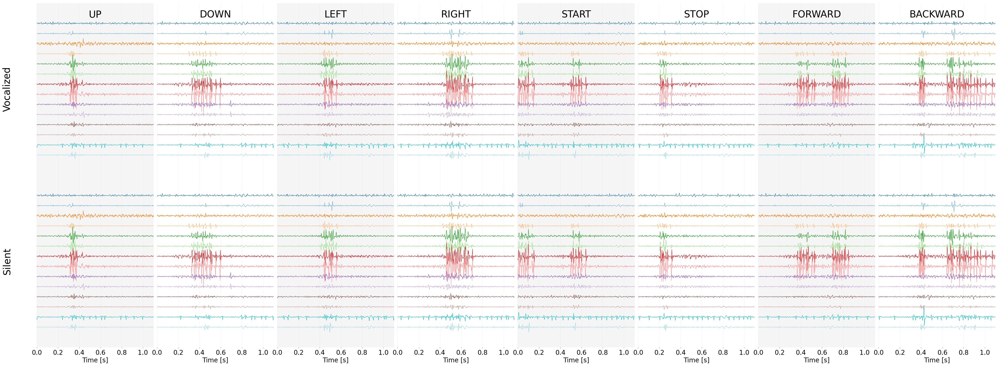

In [239]:
###### PLOT IN THE PAPER: subject 4
subject_to_consider = "S03"
main_data_dire_folder = Path("/baltic/users/ml_datasets/iis_bio_internal_datasets/2026_spacone_speech_classification_hmi")
h5_files = find_all_processed_h5(main_data_dire_folder, subject_to_consider)
fig, axs = plot_words_grid_all_channels(
    h5_files=h5_files,
    unique_words=unique_words,
    cols=cols,
    example_idx=2,
    word_title=word_title,
    channel_colors = channel_colors, 
    check_word_bounderies=check_word_bounderies,
    FS=FS,
)

# fig.savefig("words_all_channels.pdf", bbox_inches="tight")
# plt.show()


# Interpret model behaviour

In [105]:
from offline_experiments.Model_Master import Model_Master
import copy
subject_to_consider = "S02"
condition_to_consider = "silent"
model_id = "model_9"

Here, we try to understand what happens for Subject 02. 

In [106]:
main_data_dire_proc = project_root / 'data'
main_data_dire_proc = Path("/baltic/users/ml_datasets/iis_bio_internal_datasets/2026_spacone_speech_classification_hmi")
########### LOAD THE MODEL #########################

model_base_folder = rf"/scratch2/gspacone/sensors_2026_paper_results_neworder/models/inter_session_win_sweep/{subject_to_consider}/{condition_to_consider}/speechnet_padded/{model_id}"
model_base_folder = project_root / model_base_folder
run_cfg_file = model_base_folder/'run_cfg.json'

with open(run_cfg_file, "r", encoding="utf-8") as f:
    run_cfg = json.load(f)
cv_summary = pd.read_csv(model_base_folder/"cv_summary.csv")
# Get model-related info
model_cfg = run_cfg['model_cfg']['model']
model_name = model_cfg['name']
print("Model was:", model_name)
# Get info
subjects = run_cfg["base_cfg"]["data"]["subject_id"]
if type(subjects) == list:
    all_subject_models = True
elif type(subjects) == str:
    all_subject_models = False
condition = run_cfg.get("condition", "silent")
print("Model was trained on:", condition, "data" )
print("Model was trained on:", run_cfg.get("subject"), "data" )
win_size_ms = run_cfg.get("experimental_settings",{}).get("window_size_ms", "1000")
print("Window size was:", win_size_ms, "ms")


############### LOAD DATA
data_directories = return_data_directories(main_data_dire_proc=main_data_dire_proc, 
                                        sub_ids=subjects, 
                                        base_cfg=run_cfg["base_cfg"],
                                        all_subject_models=all_subject_models, 
                                        condition=condition, win_size_ms=win_size_ms)

df = pd.DataFrame()
for curr_data_dire in data_directories:
    df_curr = load_all_h5files_from_folder(curr_data_dire, key='wins_feats', print_statistics = False)
    df = pd.concat((df, df_curr))







Model was: speechnet_padded
Model was trained on: silent data
Model was trained on: S02 data
Window size was: 2000 ms
Found 15 .h5 files in: /baltic/users/ml_datasets/iis_bio_internal_datasets/2026_spacone_speech_classification_hmi/wins_and_feats_final/S02/silent/WIN_2000


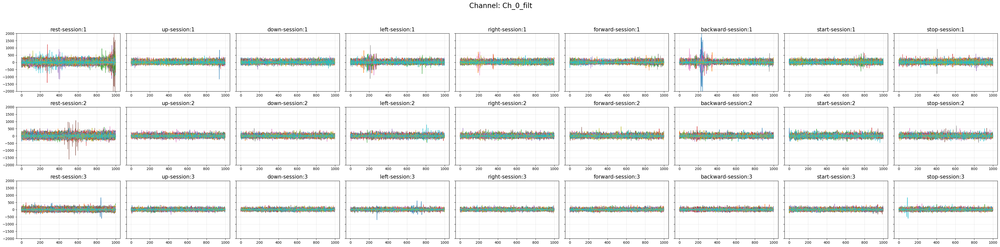

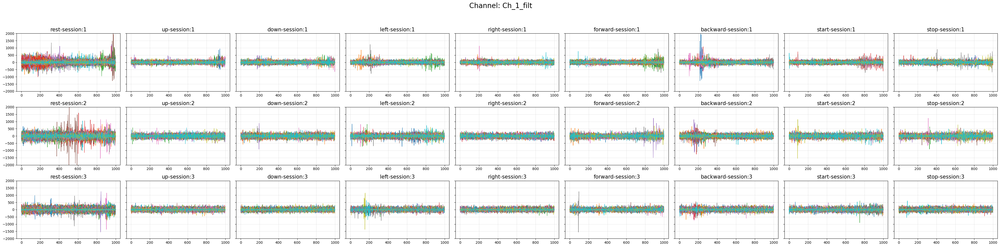

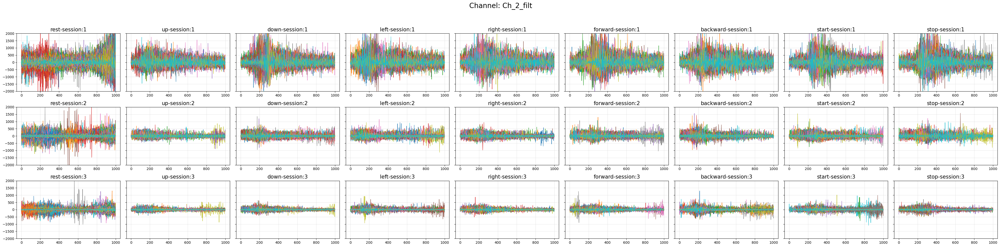

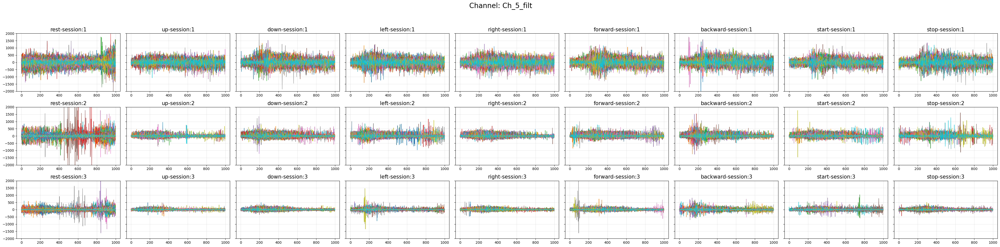

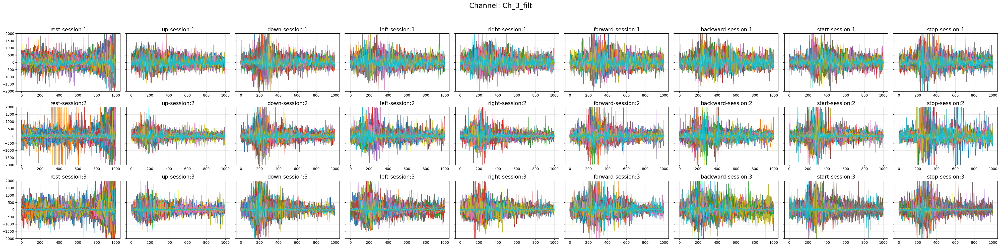

...

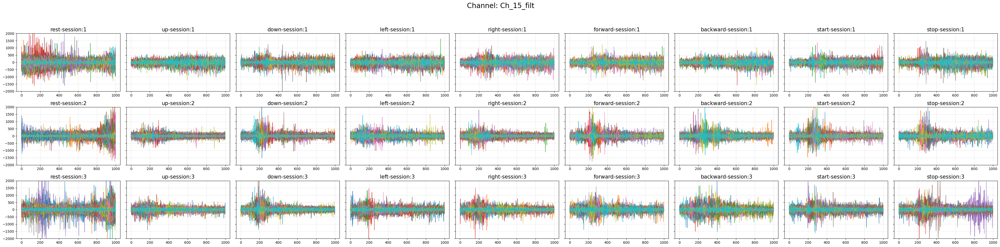

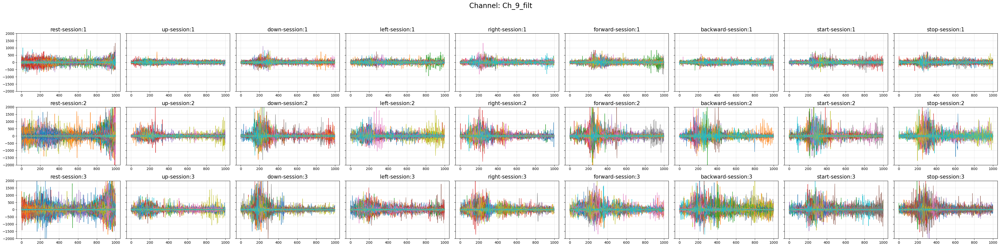

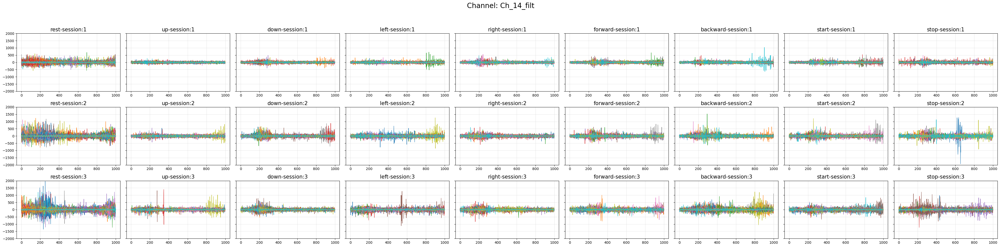

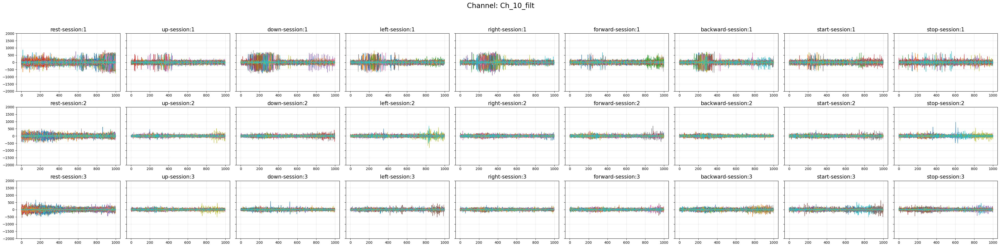

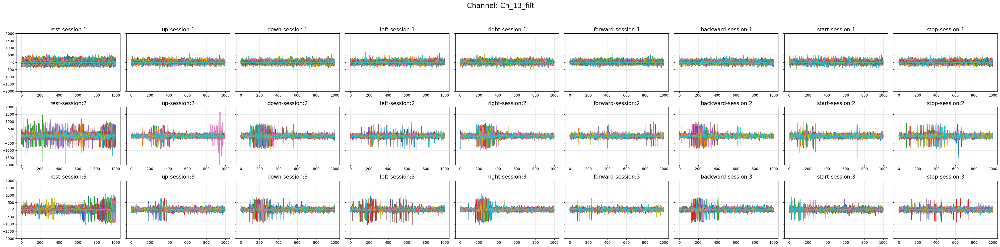

In [102]:

unique_labels = ["rest", "up", "down", "left", "right", "forward", "backward", "start", "stop"]

#@out_pdf = "all_channels_all_sessions_vocalized.pdf"

#with PdfPages(out_pdf) as pdf:
for ch_id in run_cfg["base_cfg"]["channel_order"]:

        ch_to_select = f"Ch_{ch_id}_filt"
        fig, axs = plt.subplots(3, 9, figsize=(40, 10), sharey=True)
        for session_id in range(1, 4):
            
            # isolate session
            df_sess = df[df["session_id"] == session_id]

            # keep only this channel + label
            df_single_ch = df_sess[[ch_to_select, "Label_str"]].dropna()

            # plot: 1 row, 9 cols
            

            for idx, label in enumerate(unique_labels):
                df_label = df_single_ch[df_single_ch["Label_str"] == label]
                ch_values = df_label[ch_to_select].values  # each element should be an array-like trace

                for val in ch_values:
                    axs[session_id-1][idx].plot(val, linewidth=0.8)

                axs[session_id-1][idx].grid(True, alpha=0.3)
                axs[session_id-1][idx].set_title(f"{label}-session:{session_id}", fontsize=15)
            axs[session_id-1][idx].set_ylim(-2000,2000)
        fig.suptitle(f"Channel: {ch_to_select}", fontsize=20)
        fig.tight_layout(rect=[0, 0, 1, 0.94])
        plt.show()
        #pdf.savefig(fig, bbox_inches="tight")  # add this figure as a new page
        #plt.close(fig)



In [107]:
accuracies = []

for fold_id in range(1, 4):
    
    model_to_consider = f"leave_one_session_out_fold_{fold_id}.pt"
    model_master = Model_Master(base_config=run_cfg["base_cfg"],model_config=run_cfg["model_cfg"])

    requested_fold = fold_id
    # The "model_summary_file" contains predictions from the model 
    
    summary_current_fold = cv_summary[cv_summary['fold_num'] == requested_fold]
    test_session = summary_current_fold['test_session'].values
    if len(test_session)!=1:
        print("not supported")
    else:
        test_session = test_session[0]

    print(f"Fold:{fold_id}. Model was tested on session:", test_session)

    ############## LOAD DATA ###############
    df_test = df[df['session_id'] == test_session]

    #df_test = df_test[df_test["batch_id"]==1]

    # Assing df test to model master

    model_master.df_test  = df_test
    
    model_master.generate_training_labels()
    words = list(model_master.train_label_map.items())
    model_master.remap_all_datasets()
    df_col = model_master.extract_dataset_train_columns()
    df_col = df_col + ['Label_train']
    model_master.register_model()


    # now, load weights
    cpt = torch.load(model_base_folder/model_to_consider, weights_only=False)
    # Save parameters BEFORE loading
    params_before = copy.deepcopy({k: v.clone() for k, v in model_master.model.state_dict().items()})
    # Load checkpoint
    model_master.model.load_state_dict(cpt["model_state_dict"], strict=True)

    # # Compare AFTER loading
    # changed = False
    # for k in params_before:
    #     if not torch.equal(params_before[k], model_master.model.state_dict()[k]):
    #         changed = True
    #         print(f"Parameter changed: {k}")
    #         break

    # print("Weights updated?" , changed)


    model_master.trainer_manager.test_loader = model_master.trainer_manager.create_dataloader_from_df(model_master.df_test[df_col], batch_size = 1, 
                                                                                                        shuffle = False, num_workers=0)
    metrics, y_true, y_pred = model_master.trainer_manager.evaluate()

    accuracies.append(metrics["balanced_accuracy"])

   


Fold:1. Model was tested on session: 1
Rest inclded
Num classes set to: 9
Dataset df_train is empty, skipping
Dataset df_val is empty, skipping

== df_test ==
Contains data from sessions: [1] - Batches: [2 3 1 4 5]
df_test label distribution: 0(rest)=800, 1(up)=100, 2(down)=100, 3(left)=100, 4(right)=100, 5(forward)=100, 6(backward)=100, 7(start)=100, 8(stop)=100
Total features: 14
ctx
{'num_channels': 14, 'num_samples': 1000, 'num_classes': 9}
kwargs
{'blocks_config': [{'kernel': [1, 4], 'out_channels': 8, 'pool': [1, 8]}, {'kernel': [1, 16], 'out_channels': 16, 'pool': [1, 4]}, {'kernel': [1, 8], 'out_channels': 16, 'pool': [1, 4]}, {'kernel': [7, 1], 'out_channels': 32, 'pool': [1, 1]}, {'kernel': [7, 1], 'out_channels': 32, 'pool': [1, 1]}], 'global_pool': 'avg', 'p_dropout': 0.5, 'train_cfg': {'early_stop_patience': 10, 'lr': '1e-3', 'num_epochs': 100, 'optimizer_cfg': {'lr': '1e-3', 'name': 'adam'}, 'scheduler': {'factor': 0.1, 'mode': 'min', 'name': 'ReduceLROnPlateau', 'patienc

In [108]:
accuracies

[0.46319444444444446, 0.7675000000000001, 0.5404166666666668]